# Predicting Conflict Types - NLP 

## Leveraging Data Science for ACLED(Armed Conflict Location & Event Data)

### Table of Contents

* [1. Introduction](#1.)
    * [1.1 What is ACLED?](#1.1)
    * [1.2 What is in ACLED?](#1.2)
    * [1.3 Hypothesis (What are we trying to predict?)](#1.3)
    * [1.4 Why are we Doing This?](#1.4)
* [2. Project Pipeline (DS Pipeline, Architecture Diagram)](#2)
* [3. Data Wrangling and Exploratory Data Analysis](#3)
    * [3.1 Exploratory Data Analysis](#3.1)
    * [3.1.1 Load in Dataset from CSV](#3.1.1)
    * [3.1.2 General Exploratory Analysis](#3.1.2)
    * [3.1.3 Event Type Analysis](#3.1.3)
* [4. Computation and Analysis](#4)
* [4.1 Text Pre-Processing](#4.1)
* [4.2 Word Cloud Analysis](#4.2)
* [5. Modeling and Application](#5)
    * [5.1 Model 1 - Classification Model](#5.1)
        * [5.1.1 Model 1 - Experimental Model with 2 Event Types](#5.1.1) 
        * [5.1.2 Model 1 - 6 Event Types](#5.1.2)
        * [5.1.3 Model 1 - 6 Event Types with Random Drop Sampling](#5.1.3)
    * [5.2 Topic Modeling - LDA](#5.2)
        * [5.2.1 Load in Topic Modeling visualization](#5.2.1)
        * [5.2.2 Protests LDA](#5.2.2)
        * [5.2.3 Violence Against Civilians LDA](#5.2.3)
        * [5.2.4 Battles LDA](#5.2.4)
        * [5.2.5 Riots LDA](#5.2.5)
    * [6. Reporting and Visualizations](#6)
        * [6.1 Findings](#6.1)
        * [6.2 Recommendations](#6.2)
        * [6.3 Lessons Learned](#6.3)
 

# 1. Introduction <a class="anchor" id="1.1"></a>

## 1.1 What is ACLED? <a class="anchor" id="1.1"></a>

<img src="https://github.com/georgetown-analytics/ACLED/blob/main/ACLED%20Pictures/ACLED%20Dashboard.PNG?raw=true" alt="acled landing">

The Armed Conflict Location & Event Data Project (ACLED) is a disaggregated data collection, analysis, and crisis mapping project. ACLED collects the dates, actors, locations, fatalities, and types of all reported political violence and protest events across Africa, the Middle East, Latin America & the Caribbean, East Asia, South Asia, Southeast Asia, Central Asia & the Caucasus, Europe, and the United States of America. 

The ACLED team conducts analysis to describe, explore, and test conflict scenarios, and makes both data and analysis open for free use by the public.

ACLED is a registered non-profit organization with 501(c)(3) status in the United States. ACLED receives financial support from the Bureau of Conflict and Stabilization Operations at the United States Department of State, the Dutch Ministry of Foreign Affairs, the German Federal Foreign Office, the Tableau Foundation, the International Organization for Migration, and The University of Texas at Austin.

## 1.2 What's in ACLED? <a class="anchor" id="1.2"></a>

<img src="https://github.com/georgetown-analytics/ACLED/blob/main/ACLED%20Pictures/whats%20in%20acled.PNG?raw=true" alt="what's in acled">

## 1.3 Hypothesis - What Are we Trying to Predict? <a class="anchor" id="1.3"></a>

* **Model 1** Event Type - Working within the framework of the data science pipeline our team utilized NLP against the notes (feature) section of the ACLED data to predict the event type of a particular demonstration in a region (multi classification and supervised).
* **Model 2** Sub-Event type - Topic Modeling -Using LDA to predict new sub-event types to increase new information for interventions
* **Model 3** Feeding new sub event types (model 2) back into the dataset, backfilling ACLED on new subevent types using Model 1
 <img src="https://github.com/georgetown-analytics/ACLED/blob/main/ACLED%20Pictures/event_type.PNG?raw=true" alt="event_type" width=420 height=380>

# 1.4 Why Are We Doing This? <a class="anchor" id="1.4"></a>

* Understanding Trends and creating new classifications increases the ability for agencies / governments to respond better to crisis by developing global strategies, influence current policies, and invest resources into new problem areas.
    * Improving accuracy in event types from ACLED researchers
    * Could we create sub-events that focuses on victims, i.e. gender based violence, violence against certain minorities/ protected classes? 
<img src="https://github.com/georgetown-analytics/ACLED/blob/main/ACLED%20Pictures/why%20are%20we%20doing%20this.PNG?raw=true" alt="why are we doing this" width=420 height=380>

# 2. Project Pipeline - Architecture Diagram <a class="anchor" id="2"></a>
<img src="https://github.com/georgetown-analytics/ACLED/blob/main/ACLED%20Pictures/ACLED%20design%20proposal.png?raw=true" alt="design proposal">

# 3.  Data Wrangling <a class="anchor" id="3"></a>

In this section, we explore the dataset for the first time, exploring basic questions about the data such as:

Understanding the Data
* What type of data is recorded?
* How large is the dataset?
* What data would be useful for the data model and experiment?
* Do we need to filter the data?

Data Integrity
* Are there any duplicates?
* Is there any null values?

## 3.1 Exploratory Data Analysis <a class="anchor" id="3.1"></a>

In [1]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
plt.rcParams["figure.dpi"] = 360
# displaying all columns and rows
pd.options.display.max_columns = None
pd.options.display.max_rows = None

### 3.1.1 Load in Dataset from CSV <a class="anchor" id="3.1.1"></a>

In [2]:
#load in csv from github repo
url = 'https://raw.githubusercontent.com/georgetown-analytics/ACLED/main/CSV_Main/2020-07-30-2021-07-30-United_States.csv'
df = pd.read_csv(url, index_col=0)
df = df.reset_index()

### 3.1.2 General Exploratory Analysis <a class="anchor" id="3.1.2"></a>

In [3]:
# look at first 5 rows of data
df.head()

,data_id,iso,event_id_cnty,event_id_no_cnty,event_date,year,time_precision,event_type,sub_event_type,actor1,assoc_actor_1,inter1,actor2,assoc_actor_2,inter2,interaction,region,country,admin1,admin2,admin3,location,latitude,longitude,geo_precision,source,source_scale,notes,fatalities,timestamp,iso3
0,8418110,840,USA32841,32841,30 July 2021,2021,1,Protests,Peaceful protest,Protesters (United States),NaN,6,NaN,NaN,0,60,North America,United States,California,Los Angeles,NaN,Los Angeles,34.0433,-118.2495,1,CBS2 (Los Angeles),Subnational,"On 30 July 2021, about 50 people rallied outsi...",0,1628032459,USA
1,8418114,840,USA32857,32857,30 July 2021,2021,1,Protests,Peaceful protest,Protesters (United States),NaN,6,NaN,NaN,0,60,North America,United States,California,San Diego,NaN,San Diego,32.7174,-117.1660,1,CBS8 (San Diego),Subnational,"On 30 July 2021, about 30 people staged a 'Sav...",0,1628032459,USA
2,8418118,840,USA32951,32951,30 July 2021,2021,1,Protests,Peaceful protest,Protesters (United States),NaN,6,NaN,NaN,0,60,North America,United States,Nevada,Washoe,NaN,Reno,39.5296,-119.8138,1,Channel 4 (Reno),Subnational,"On 30 July 2021, several people rallied outsid...",0,1628032459,USA
3,8418128,840,USA32967,32967,30 July 2021,2021,1,Protests,Peaceful protest,Protesters (United States),NaN,6,NaN,NaN,0,60,North America,United States,New York,Ulster,NaN,Kingston,41.9265,-73.9988,1,Daily Freeman,Subnational,"On 30 July 2021, about 40 people marched to th...",0,1628032459,USA
4,8418130,840,USA32998,32998,30 July 2021,2021,1,Protests,Peaceful protest,Protesters (United States),Health Workers (United States); Labour Group (...,6,NaN,NaN,0,60,North America,United States,South Dakota,Minnehaha,NaN,Sioux Falls,43.5499,-96.7003,1,Dakota News Now,Subnational,"On 30 July 2021, more than 100 people includin...",0,1628032459,USA


In [4]:
# see how many rows and columns are in this dataset
shape_info = df.shape 
print('This dataset contains {} rows  and {} columns' 
      .format(shape_info[0], 
              shape_info[1]))

This dataset contains 18212 rows  and 31 columns


In [5]:
# see list of all columns
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18212 entries, 0 to 18211
Data columns (total 31 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   data_id           18212 non-null  int64  
 1   iso               18212 non-null  int64  
 2   event_id_cnty     18212 non-null  object 
 3   event_id_no_cnty  18212 non-null  int64  
 4   event_date        18212 non-null  object 
 5   year              18212 non-null  int64  
 6   time_precision    18212 non-null  int64  
 7   event_type        18212 non-null  object 
 8   sub_event_type    18212 non-null  object 
 9   actor1            18212 non-null  object 
 10  assoc_actor_1     12216 non-null  object 
 11  inter1            18212 non-null  int64  
 12  actor2            1964 non-null   object 
 13  assoc_actor_2     716 non-null    object 
 14  inter2            18212 non-null  int64  
 15  interaction       18212 non-null  int64  
 16  region            18212 non-null  object

In [6]:
print(df.iloc[0:10]['notes'])

0    On 30 July 2021, about 50 people rallied outsi...
1    On 30 July 2021, about 30 people staged a 'Sav...
2    On 30 July 2021, several people rallied outsid...
3    On 30 July 2021, about 40 people marched to th...
4    On 30 July 2021, more than 100 people includin...
5    On 30 July 2021, family and supporters rallied...
6    On 30 July 2021, around a hundred people, incl...
7    On 30 July 2021, people and members of the St....
8    On 30 July 2021, people rallied outside City H...
9    On 30 July 2021, more than a dozen people orga...
Name: notes, dtype: object


In [7]:
example_notes = df.iloc[0]
print(example_notes['notes'])

On 30 July 2021, about 50 people rallied outside Mayor Eric Garcetti's (D) home in Los Angeles (California) against the Mayor's recently signed ordinance restricting homeless encampments in the city. Demonstrators toilet papered and graffitied the house. Police were dispatched to disperse the demonstrators, but they had left by the time police arrived. [size=about 50]


In [8]:
#selecting columns that are pertient to the project
df_filter = df[['country', 'actor1', 'assoc_actor_1','event_type','sub_event_type', 'region', 'source','fatalities', 'latitude', 'longitude', 'notes']]

In [9]:
df_filter

,country,actor1,assoc_actor_1,event_type,sub_event_type,region,source,fatalities,latitude,longitude,notes
0,United States,Protesters (United States),NaN,Protests,Peaceful protest,North America,CBS2 (Los Angeles),0,34.0433,-118.2495,"On 30 July 2021, about 50 people rallied outsi..."
1,United States,Protesters (United States),NaN,Protests,Peaceful protest,North America,CBS8 (San Diego),0,32.7174,-117.1660,"On 30 July 2021, about 30 people staged a 'Sav..."
2,United States,Protesters (United States),NaN,Protests,Peaceful protest,North America,Channel 4 (Reno),0,39.5296,-119.8138,"On 30 July 2021, several people rallied outsid..."
3,United States,Protesters (United States),NaN,Protests,Peaceful protest,North America,Daily Freeman,0,41.9265,-73.9988,"On 30 July 2021, about 40 people marched to th..."
4,United States,Protesters (United States),Health Workers (United States); Labour Group (...,Protests,Peaceful protest,North America,Dakota News Now,0,43.5499,-96.7003,"On 30 July 2021, more than 100 people includin..."
5,United States,Protesters (United States),Latinx Group (United States),Protests,Peaceful protest,North America,Fox40 (Sacramento),0,37.6428,-120.9918,"On 30 July 2021, family and supporters rallied..."
6,United States,Protesters (United States),Health Workers (United States); Labour Group (...,Protests,Peaceful protest,North America,Herald Sun,0,35.9940,-78.8986,"On 30 July 2021, around a hundred people, incl..."
7,United States,Protesters (United States),NAACP: National Association for the Advancemen...,Protests,Peaceful protest,North America,KMOV4,0,38.6270,-90.1913,"On 30 July 2021, people and members of the St...."
8,United States,Protesters (United States),NaN,Protests,Peaceful protest,North America,KPBS,0,32.7174,-117.1660,"On 30 July 2021, people rallied outside City H..."
9,United States,Protesters (United States),NaN,Protests,Peaceful protest,North America,Middletown Press,0,41.5623,-72.6507,"On 30 July 2021, more than a dozen people orga..."


### 3.1.3 Event Type Analysis <a class="anchor" id="3.1.3"></a>

In [10]:
conflict_count = df_filter.groupby(['event_type','sub_event_type'])['sub_event_type'].count().to_frame()

In [11]:
conflict_count

sub_event_type
event_type                 sub_event_type                                    
Battles                    Armed clash                                      6
Explosions/Remote violence Grenade                                          1
                           Remote explosive/landmine/IED                    4
                           Suicide bomb                                     1
Protests                   Excessive force against protesters              65
                           Peaceful protest                             16373
                           Protest with intervention                      465
Riots                      Mob violence                                    49
                           Violent demonstration                          381
Strategic developments     Arrests                                         34
                           Change to group/activity                       207
                           Disrupted weapons use                            8
                           Looting/property destruction                    19
                           Other                                          513
Violence against civilians Attack                                          85
                           Sexual violence                                  1

In [12]:
# event distribution by event_type and region

region_event_count=df_filter.pivot_table(index="region",
                 columns=["event_type"],
                 values="notes",
                 aggfunc="count",
                 margins=True)

region_event_count

event_type,Battles,Explosions/Remote violence,Protests,Riots,Strategic developments,Violence against civilians,All
region,,,,,,,
North America,6,6,16903,430,781,86,18212
All,6,6,16903,430,781,86,18212


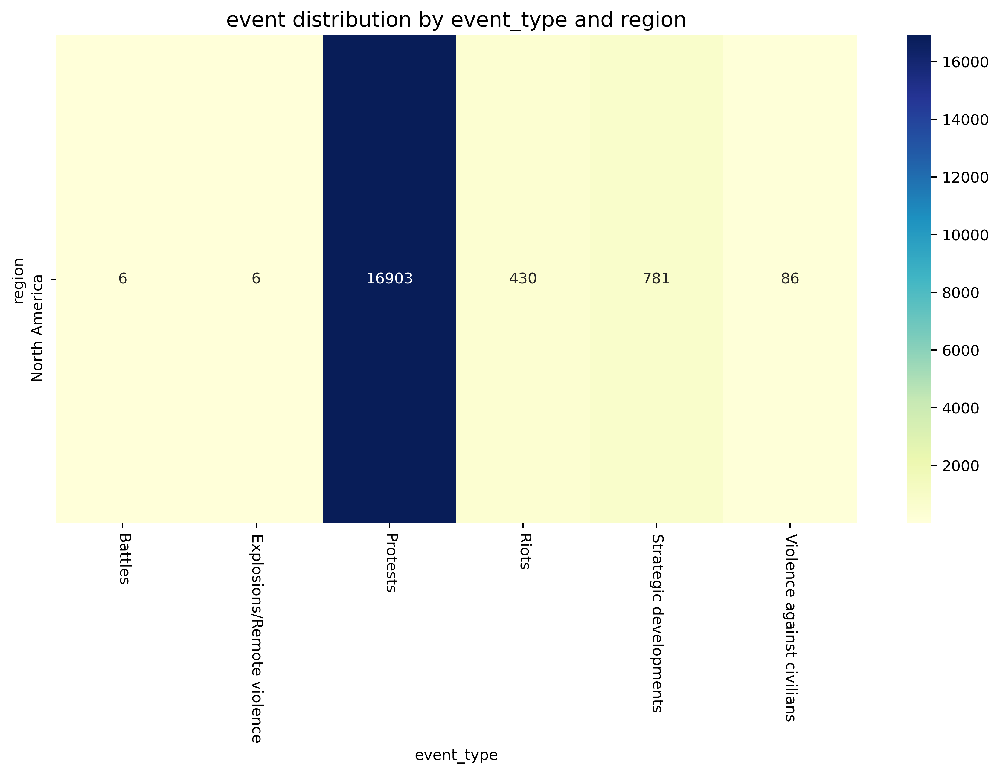

In [13]:
plt.figure(figsize=(12,6))

region_event_count2=df_filter.pivot_table(index="region",
                 columns=["event_type"],
                 values="notes",
                 aggfunc="count",
                 margins=False)

_=sns.heatmap(region_event_count2, 
            cmap="YlGnBu",
            annot=True,
              fmt='d')
_=plt.xticks(rotation=-90)
_=plt.title("event distribution by event_type and region",fontsize=14)

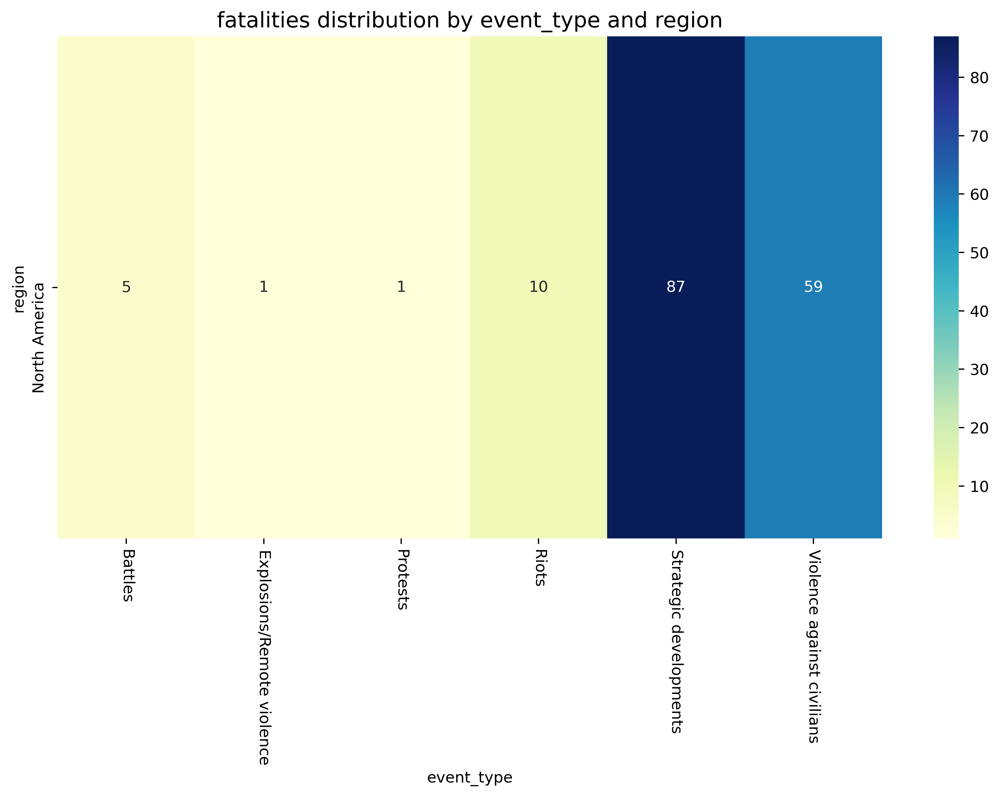

In [14]:

plt.figure(figsize=(12,6))

region_fatality_count2=df_filter.pivot_table(index="region",
                 columns=["event_type"],
                 values="fatalities",
                 aggfunc="sum",
                 margins=False)

_=sns.heatmap(region_fatality_count2, 
            cmap="YlGnBu",
            annot=True,
              fmt='d')
_=plt.xticks(rotation=-90)
_=plt.title("fatalities distribution by event_type and region",fontsize=14)

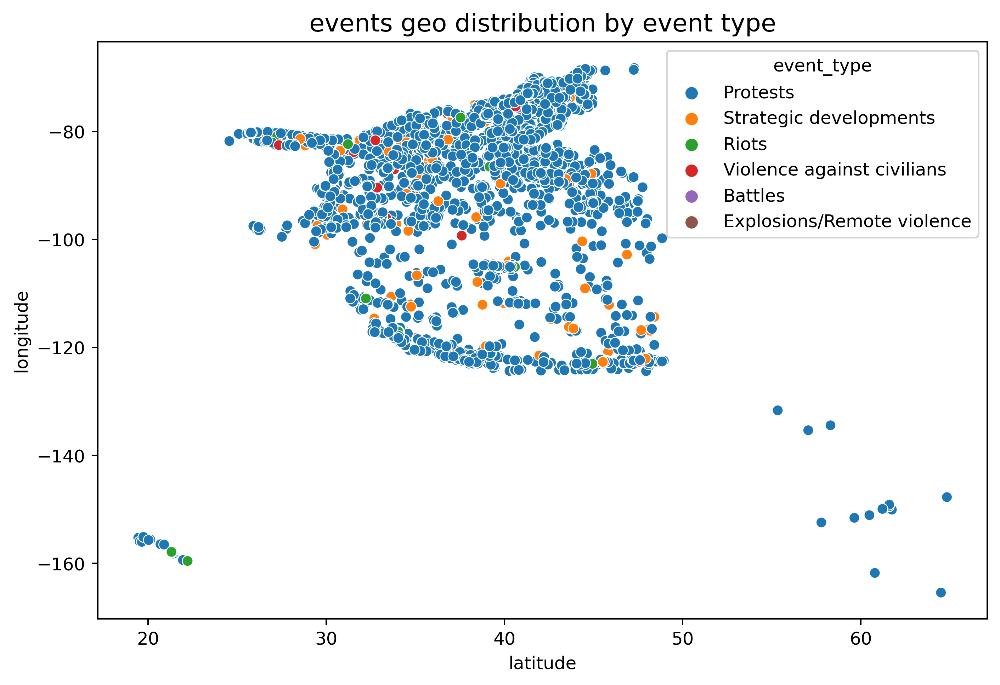

In [15]:
# event type distribution by geo

plt.figure(figsize=(9,6))
_=sns.scatterplot(x="latitude",
                  y="longitude",
                  hue="event_type",
                  data=df_filter)
_=plt.title("events geo distribution by event type",fontsize=14)

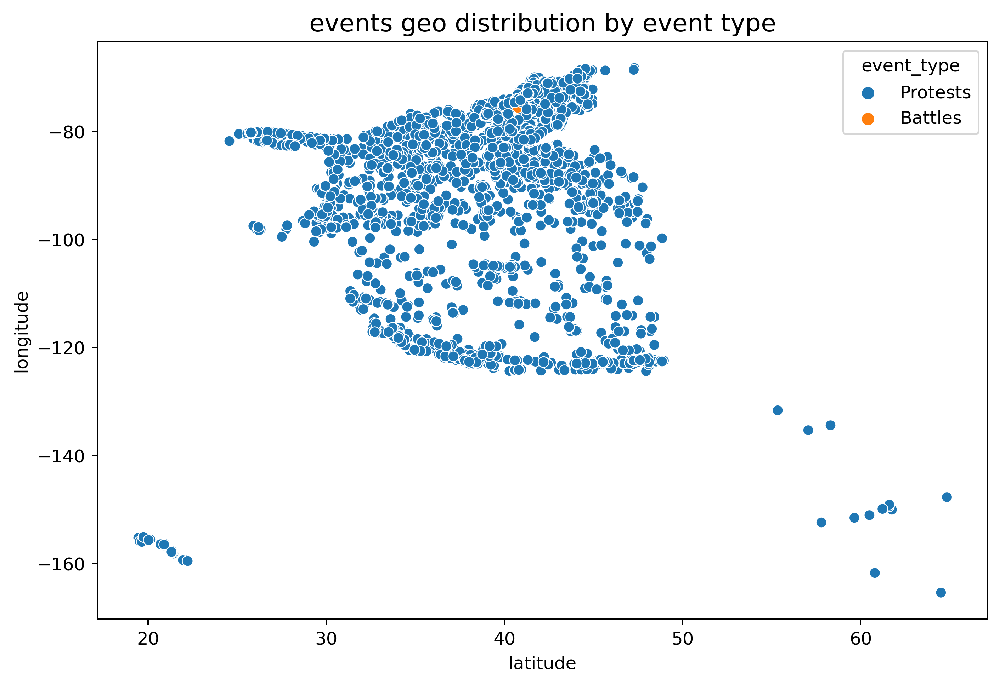

In [16]:
# if we only consider Protests and Battles type

plt.figure(figsize=(9,6))
_=sns.scatterplot(x="latitude",
                  y="longitude",
                  hue="event_type",
                  data=df_filter[df_filter["event_type"].isin(["Protests","Battles"])])
_=plt.title("events geo distribution by event type",fontsize=14)

# 4. Computation and Analysis <a class="anchor" id="4"></a>

## 4.1 Text Pre-Processing <a class="anchor" id="4.1"></a>

In this section, we will go through the common text pre-processing steps to prepare our data for Natural Language Processing (NLP) Modeling.

Common steps we took:
* Converting the text into lower case letters
* Removing numbers
* Removing stop words
    * stop words are words which are filtered out before or after processing of natural language data Though “stop words” usually refers to the most common words in a language, there is no single universal list of stop words used by all natural language processing tools.
* Lemmatization
    * Lemmatization is the process of grouping together the different inflected forms of a word so they can be analysed as a single item. Lemmatization is similar to stemming but it brings context to the words. So it links words with similar meaning to one word.
* Tokenization
    * Tokenization is about splitting strings of text into smaller pieces, or “tokens”. Paragraphs can be tokenized into sentences and sentences can be tokenized into words.
    
ACLED specific steps we took:
* Removing common ACLED words
* Removing months

In [17]:
import nltk
import re
import string 
from string import digits
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk.stem import PorterStemmer
from nltk.tokenize import RegexpTokenizer
from nltk import word_tokenize,pos_tag
from nltk.stem.lancaster import LancasterStemmer
from nltk.stem import WordNetLemmatizer
ps = PorterStemmer()

In [18]:
def common_acled_words(text):
    common_acled_words = ['report', 'size','january', 'feburary', 'march','april','may','june','july','august','september','october','november','december']
    words =[w for w in text if w not in common_acled_words]
    return words

In [19]:
data_sub=df[["event_type","notes"]]

In [20]:
# remove date info in notes

data_sub["notes"].map(lambda x: x.split(",")[0]).value_counts().head()

On 22 August 2020       336
On 26 September 2020    186
On 17 October 2020      183
On 7 November 2020      163
On 29 August 2020       156
Name: notes, dtype: int64

In [21]:
data_sub["notes"]=data_sub["notes"].map(lambda x: ",".join(x.split(",")[1:]))

C:\Users\dhmph\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [22]:
# define cleaning function 

# Remove extra space, word segmentation, part-of-speech tagging
def tokenize(sentence):
    sentence = re.sub(r'\s+', ' ', sentence)
    token_words = word_tokenize(sentence)
    token_words = pos_tag(token_words)   
    return token_words

# Normalize the word form
def stem(token_words):
    wordnet_lematizer = WordNetLemmatizer()
    words_lematizer = []
    for word, tag in token_words:
        if tag.startswith('NN'):
            word_lematizer =  wordnet_lematizer.lemmatize(word, pos='n')  # n-noun
        elif tag.startswith('VB'): 
            word_lematizer =  wordnet_lematizer.lemmatize(word, pos='v')   # v-verb
        elif tag.startswith('JJ'): 
            word_lematizer =  wordnet_lematizer.lemmatize(word, pos='a')   # adjective
        elif tag.startswith('R'): 
            word_lematizer =  wordnet_lematizer.lemmatize(word, pos='r')   # r-pronoun
        else: 
            word_lematizer =  wordnet_lematizer.lemmatize(word)
        words_lematizer.append(word_lematizer)
    return words_lematizer

# Remove stopwords 
def delete_stopwords(token_words):
    cleaned_words = [word for word in token_words if word not in stopwords.words('english')]
    return cleaned_words

# Determine whether the string is a number
def is_number(s):
    try:
        float(s)
        return True
    except ValueError:
        pass
 
    try:
        import unicodedata
        unicodedata.numeric(s)
        return True
    except (TypeError, ValueError):
        pass
 
    return False

# Remove Special words and numbers
def delete_characters(token_words):
    words_list = [word for word in token_words if word not in string.punctuation and not is_number(word)]
    return words_list

# Combine the above steps and perform text preprocessing
def pre_process(text):
    token_words = tokenize(text)
    token_words = stem(token_words)    
    token_words = delete_stopwords(token_words)
    token_words = delete_characters(token_words)    
    cleaned_text=" ".join(token_words)
    return cleaned_text

In [23]:
# apply clean

data_sub["notes"]=data_sub["notes"].map(lambda x: pre_process(x))
data_sub.head()

C:\Users\dhmph\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,event_type,notes
0,Protests,people rally outside Mayor Eric Garcetti 's D ...
1,Protests,people stag 'Save 30th Street Parking rally Sa...
2,Protests,several people rally outside Washoe Public Lib...
3,Protests,people march Ulster County office building upt...
4,Protests,people include health worker employee Sanford ...


In [24]:
#making all text in notes column lowercase
df["notes"]=df["notes"].str.lower()

In [25]:
def remove_num(list):
    pattern = '[0-9]'
    list = [re.sub(pattern, '', i) for i in list]
    return list  

In [26]:
df["notes"] = remove_num(df["notes"])

In [27]:
tokenizer = RegexpTokenizer(r'\w+')
df["notes"] = df["notes"].apply(lambda x: tokenizer.tokenize(x.lower()))

In [28]:
lemmatizer = WordNetLemmatizer()

def word_lemmatizer(text):
    lem_text = [lemmatizer.lemmatize(i) for i in text]
    return lem_text

In [29]:
def remove_stopwords(text):
    words = [w for w in text if w not in stopwords.words('english')]
    return words

In [ ]:
df["notes"] = df["notes"].apply(lambda x: remove_stopwords(x))

In [ ]:
def remove_month(text):
    dates = ['january', 'feburary', 'march','april','may','june','july','august','september','october','november','december']
    words =[w for w in text if w not in dates]
    return words

In [ ]:
df["notes"] = df["notes"].apply(lambda x: remove_month(x))

In [ ]:
def remove_month(text):
    dates = ['january', 'feburary', 'march','april','may','june','july','august','september','october','november','december']
    words =[w for w in text if w not in dates]
    return words

In [ ]:
def common_acled_words(text):
    common_acled_words = ['report', 'size', 'protest']
    words =[w for w in text if w not in common_acled_words]
    return words

In [ ]:
df["notes"] = df["notes"].apply(lambda x: common_acled_words(x))

In [ ]:
#create sub dataframes for each event type
df_protests = df.loc[df['event_type'] == "Protests"]
df_riots = df.loc[df['event_type'] == "Riots"]
df_battles = df.loc[df['event_type'] == "Battles"]
df_violence_civilians = df.loc[df['event_type'] == "Violence against civilians"]
df_explosions = df.loc[df['event_type'] == "Explosions/Remote violence"]
df_development = df.loc[df['event_type'] == "Strategic developments"]

## 4.2 Word Cloud Analysis <a class="anchor" id="4.2"></a>

* The number of events that occur in different regions can be calculated to determine which regions and which event types occur more frequently.Numerical visualization, the darker the color indicates the more times the event occurred.

* The following is the notes word cloud map for each event according to event type. The main purpose is to see the differences in the use of words in notes description under different event types, and what kind of words are used more in what events. If the classification model of Event type is to be made based on notes content, it is feasible to show the difference of notes description words in different event types first.
* From the word cloud map, we can see that there are clear differences in the use of different event types.


In [ ]:
from wordcloud import WordCloud

In [ ]:
df_filter=data_sub[['event_type', 'notes']]

In [ ]:
# generate notes text by event_type

event_type_notes=df_filter.dropna(subset=['notes']).groupby("event_type")["notes"].apply(list).to_dict()
print(event_type_notes.keys())

In [ ]:

for k in event_type_notes.keys():
    
    text="".join(str(event_type_notes[k]))

    wc = WordCloud(width=900, height=500, 
                   mode='RGBA', background_color=None,
                   min_font_size=12,max_font_size=72,
                   collocations=False,prefer_horizontal=0.8,
                   max_words=100).generate(text)

    # show wordcloud img
    plt.figure(figsize=(9,5),dpi=100)
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.title("word cloud of event type= {} \n{}".format(k,'- '*40),fontsize=24,color='red')
    plt.show()
    print()

# 5. Modeling and Application <a class="anchor" id="5"></a>

Model 1: We are going to train a model that will predict the event type (target) of a particular event in a region (multi classification). This will be supervised learning as the input and output is already labelled. We are choosing the event type column to ensure that the model has no major errors in the data cleaning and wrangling process before continuing to more difficult models. Once we’ve established a working model, we would move to the next stage of the product.

Model 2 :We are going to train a model that will predict the sub-event type (target) of a particular event in a region (multi classification). Various features will be analyzed in an unsupervised fashion to identify any new clusters, and help determine the best predictor of the sub-event type. New features would include:
* Fatalities
* Region

Identifying new sub-event type clusters would increase the insights drawn from the notes and summary of each event. An example of this would identify gender based violence or violence against a minority class as a sub-event of Violence Against Civilians.

Types of Models
* Supervised Learning
    * Logistics Regression,
    * Random Forest 
    * Multinomial Naive Bayes, 

* Unsupervised Learning
    * Topic Modeling/LDA
    * K-Means

## 5.1 Model 1 - Classification Model <a class="anchor" id="5.1"></a>

The first model is an experimental model, testing the implementation of one model that we select, based on two kinds of events to reduce errors in testing and runtime.
* Protests
* Battles

### 5.1.1 Model 1 - Experimental Model with 2 Event Types <a class="anchor" id="5.1.1"></a>

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer,TfidfVectorizer

# from sklearn.naive_bayes import MultinomialNB
# from sklearn.linear_model import LogisticRegression
# from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,auc,accuracy_score,f1_score
from sklearn.model_selection import GridSearchCV

In [ ]:
# Define two functions that will be used later in the drawing

def plotConfusionMaxtrix(confmat_data=None,xlabel='',ylabel='',title='',cmap=plt.cm.Blues,plt_ax=None):
    """
    Used for drawing - confusion matrix
    """
    plt_ax.matshow(confmat_data, cmap=cmap, alpha=0.75)
    for i in range(confmat_data.shape[0]):
        for j in range(confmat_data.shape[1]):
            plt_ax.text(x=j, y=i,s=confmat_data[i, j],va='center', ha='center',fontsize=12)
    plt_ax.set_xlabel(xlabel,fontsize=12)
    plt_ax.set_ylabel(ylabel,fontsize=12)
    plt_ax.set_title(title,fontsize=12)
    return 


def plotRocBinary(fpr=None,tpr=None,roc_auc=None,color='red',title='',plot_ax=None):
    plot_ax.plot(fpr, tpr, c=color,linewidth=2,label='ROC Curve (auc = %0.3f)' % roc_auc)
    plot_ax.plot([0, 1], [0, 1], 'k--',label='Random Prediction')
    plot_ax.set_xlim([0.0, 1.0])
    plot_ax.set_ylim([0.0, 1.0])
    plot_ax.set_xlabel('1 - Specifity',fontsize=12)
    plot_ax.set_ylabel('Sensitivity',fontsize=12)
    plot_ax.set_title(title,fontsize=12)
    for key in ["left","right","top","bottom"]:
        plot_ax.spines[key].set_alpha(0.3)
    plot_ax.legend(loc="lower right")
    return

In [ ]:
# perpare x and y 
data_model=data_sub[data_sub["event_type"].isin(["Protests","Battles"])][["notes","event_type"]]
x=data_model["notes"]
y=data_model["event_type"].map({"Protests":0,"Battles":1})

# split train set and test set
xtrain,xtest,ytrain,ytest=train_test_split(x,y,test_size=0.3,random_state=1)

In [ ]:
# Extract text features using TFIDF

vectorizer = TfidfVectorizer(min_df=3,max_df=0.3)
xtrain_vectorizer=vectorizer.fit_transform(xtrain)
xtest_vectorizer =vectorizer.transform(xtest)

In [ ]:
# Random forest was used as the classification model, and the super parameters were adjusted to make the model best

rf=RandomForestClassifier(random_state=42)

# set tune parameter
parameters = {'max_depth': range(3,51)}

grid_rf = GridSearchCV(rf, parameters,cv=5, n_jobs=-1)
grid_rf.fit(xtrain_vectorizer,ytrain)

# The optimal depth is 38
print("best_params: ",grid_rf.best_params_)

In [ ]:
# Look at the model's classification report on training data and test data

pred_ytrain_grid_rf=grid_rf.predict(xtrain_vectorizer)
pred_ytest_grid_rf=grid_rf.predict(xtest_vectorizer)

proba_ytrain_grid_rf=grid_rf.predict_proba(xtrain_vectorizer)
proba_ytest_grid_rf=grid_rf.predict_proba(xtest_vectorizer)

print("="*60)
print(" "*5,"Train Data Classification Report")
print(classification_report(ytrain,pred_ytrain_grid_rf))
print("="*60)

print(" "*5,"Test Data Classification Report")
print(classification_report(ytest,pred_ytest_grid_rf))
print("="*60)

### 5.1.2 Model 1 - 6 Event Types <a class="anchor" id="5.1.2"></a>

In [ ]:
# A function that defines the ROC of a multi-classification problem The ROC of multi-classification is not the same as the ROC of dichotomies

def plotRocMulti(fpr=None,tpr=None,roc_auc=None,title='',plot_ax=None):
    # plot Roc for each category
    colors=['peru','darkcyan','cyan','purple','red','blue']
    for i, color in zip(range(6), colors):
        plot_ax.plot(fpr[i], tpr[i], color=color, lw=2,label='ROC curve of Class:{0}(auc = {1:0.3f})'.format(i, roc_auc[i]))

    plot_ax.plot([0, 1], [0, 1], 'k--', lw=1)
    plot_ax.set_xlim([0.0, 1.0])
    plot_ax.set_ylim([0.0, 1.0])
    plot_ax.set_xlabel('1 - Specifity',fontsize=12)
    plot_ax.set_ylabel('Sensitivity',fontsize=12)
    plot_ax.set_title(title,fontsize=12)
    for key in ["left","right","top","bottom"]:
        plot_ax.spines[key].set_alpha(0.3)
    plot_ax.legend(loc="lower right")
    return

In [ ]:
# Extract text features using TFIDF

vectorizer6 = TfidfVectorizer(min_df=3,max_df=0.3)
xtrain_vectorizer6=vectorizer6.fit_transform(xtrain)
xtest_vectorizer6 =vectorizer6.transform(xtest)

In [ ]:
# Random forest was used as the classification model, and the super parameters were adjusted to make the model best

rf=RandomForestClassifier(random_state=42)

# set tune parameter
parameters = {'max_depth': range(5,101,2)}

grid_rf6 = GridSearchCV(rf, parameters,cv=5, n_jobs=-1)
grid_rf6.fit(xtrain_vectorizer6,ytrain)

# The optimal depth is 97
print("best_params: ",grid_rf6.best_params_)

In [ ]:
# Look at the model's classification report on training data and test data

pred_ytrain_grid_rf6=grid_rf6.predict(xtrain_vectorizer6)
pred_ytest_grid_rf6=grid_rf6.predict(xtest_vectorizer6)

print("="*60)
print(" "*5,"Train Data Classification Report")
print(classification_report(ytrain,pred_ytrain_grid_rf6))
print("="*60)

print(" "*5,"Test Data Classification Report")
print(classification_report(ytest,pred_ytest_grid_rf6))
print("="*60)

In [ ]:
# perpare x and y 
data_model_6=data_sub[["notes","event_type"]].copy()
x=data_model_6["notes"]
y=data_model_6["event_type"].map({"Protests":0,
                                  "Battles":1,
                                  "Violence against civilians":2,
                                  "Riots":3,
                                  "Strategic developments":4,
                                  "Explosions/Remote violence":5})

# split train set and test set
xtrain,xtest,ytrain,ytest=train_test_split(x,y,test_size=0.3,random_state=1)

In [ ]:
# Visualize the confusion matrix

confmat_train6 = confusion_matrix(y_true=ytrain, y_pred=pred_ytrain_grid_rf6)
confmat_test6 = confusion_matrix(y_true=ytest, y_pred=pred_ytest_grid_rf6)

# Plot Confusion Matrix
fig, (ax1, ax2) = plt.subplots(nrows=1,ncols=2,figsize=(16, 7))
#plot for train data
plotConfusionMaxtrix(confmat_data=confmat_train6,
                     xlabel='Predicted Label',
                     ylabel='True Label',
                     title='Train Data Confusion Matrix',
                     cmap=plt.cm.Blues,
                     plt_ax=ax1)
#plot for test data
plotConfusionMaxtrix(confmat_data=confmat_test6,
                     xlabel='Predicted Label',
                     ylabel='True Label',
                     title='Test Data Confusion Matrix',
                     cmap=plt.cm.Greens,
                     plt_ax=ax2)
plt.show()

In [ ]:
# Look at the model's classification report on training data and test data

pred_ytrain_grid_rf6=grid_rf6.predict(xtrain_vectorizer6)
pred_ytest_grid_rf6=grid_rf6.predict(xtest_vectorizer6)

print("="*60)
print(" "*5,"Train Data Classification Report")
print(classification_report(ytrain,pred_ytrain_grid_rf6))
print("="*60)

print(" "*5,"Test Data Classification Report")
print(classification_report(ytest,pred_ytest_grid_rf6))
print("="*60)

In [ ]:
from sklearn.preprocessing import label_binarize

proba_ytrain_grid_rf6=grid_rf6.predict_proba(xtrain_vectorizer6)
proba_ytest_grid_rf6=grid_rf6.predict_proba(xtest_vectorizer6)

# Training data ROC
train_fpr = dict()
train_tpr = dict()
train_roc_auc = dict()
ytrain_bin = label_binarize(ytrain, classes=[0, 1, 2,3,4,5])
# Calculate the FPR TPR AUC for each category
for i in range(6):
    train_fpr[i], train_tpr[i], _ = roc_curve(ytrain_bin[:, i], proba_ytrain_grid_rf6[:, i])
    train_roc_auc[i] = auc(train_fpr[i], train_tpr[i])
    
# Test the ROC of data
test_fpr = dict()
test_tpr = dict()
test_roc_auc = dict()
ytest_bin = label_binarize(ytest, classes=[0, 1, 2,3,4,5])
# Calculate the FPR TPR AUC for each category
for i in range(6):
    test_fpr[i], test_tpr[i], _ = roc_curve(ytest_bin[:, i], proba_ytest_grid_rf6[:, i])
    test_roc_auc[i] = auc(test_fpr[i], test_tpr[i])
    
# draw
fig, (ax1, ax2) = plt.subplots(nrows=1,ncols=2,figsize=(16, 7))
plotRocMulti(fpr=train_fpr,tpr=train_tpr,roc_auc=train_roc_auc,title='ROC: Train Data',plot_ax=ax1)
plotRocMulti(fpr=test_fpr,tpr=test_tpr,roc_auc=test_roc_auc,title='ROC: Test Data',plot_ax=ax2)

### 5.1.3 Model 1 - 6 Event Types with Random Drop Sampling <a class="anchor" id="5.1.3"></a>

In [ ]:
# imblearn Used to deal with unbalanced sample problems

from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline

In [ ]:
# Visualize the confusion matrix

confmat_train_pipe = confusion_matrix(y_true=ytrain, y_pred=pred_ytrain_grid_rf_pipe)
confmat_test_pipe = confusion_matrix(y_true=ytest, y_pred=pred_ytest_grid_rf_pipe)

# Plot Confusion Matrix
fig, (ax1, ax2) = plt.subplots(nrows=1,ncols=2,figsize=(16, 7))
#plot for train data
plotConfusionMaxtrix(confmat_data=confmat_train_pipe,
                     xlabel='Predicted Label',
                     ylabel='True Label',
                     title='Train Data Confusion Matrix',
                     cmap=plt.cm.Blues,
                     plt_ax=ax1)
#plot for test data
plotConfusionMaxtrix(confmat_data=confmat_test_pipe,
                     xlabel='Predicted Label',
                     ylabel='True Label',
                     title='Test Data Confusion Matrix',
                     cmap=plt.cm.Greens,
                     plt_ax=ax2)
plt.show()

In [ ]:
# Look at the model's classification report on training data and test data

pred_ytrain_grid_rf_pipe=grid_rf_pipe.predict(xtrain_vectorizer6)
pred_ytest_grid_rf_pipe=grid_rf_pipe.predict(xtest_vectorizer6)

proba_ytrain_grid_rf_pipe=grid_rf_pipe.predict_proba(xtrain_vectorizer6)
proba_ytest_grid_rf_pipe=grid_rf_pipe.predict_proba(xtest_vectorizer6)

print("="*60)
print(" "*5,"Train Data Classification Report")
print(classification_report(ytrain,pred_ytrain_grid_rf_pipe))
print("="*60)

print(" "*5,"Test Data Classification Report")
print(classification_report(ytest,pred_ytest_grid_rf_pipe))
print("="*60)

In [ ]:

# A balanced sample training model is constructed by random falling sampling

# The first step in building a pipeline is to do random drop sampling and the second step is classifier
rf_pipe = Pipeline(
    [
        ('sampling', RandomUnderSampler(random_state=42)),
        ('classifier', RandomForestClassifier(random_state=42))   
    ])

# search for best parameters by GridSearchCV
parameters = {'classifier__max_depth': range(5,101,2)}

grid_rf_pipe = GridSearchCV(rf_pipe, parameters,cv=5,n_jobs=-1)
grid_rf_pipe.fit(xtrain_vectorizer6,ytrain)

# The optimal depth is 95
print("best_params: ",grid_rf_pipe.best_params_)

In [ ]:
# Predict the probability of each class of events
proba_ytrain_grid_rf_pipe=grid_rf_pipe.predict_proba(xtrain_vectorizer6)
proba_ytest_grid_rf_pipe=grid_rf_pipe.predict_proba(xtest_vectorizer6)

# Training data ROC
train_fpr = dict()
train_tpr = dict()
train_roc_auc = dict()
ytrain_bin = label_binarize(ytrain, classes=[0, 1, 2,3,4,5])
# Calculate the FPR TPR AUC for each category
for i in range(6):
    train_fpr[i], train_tpr[i], _ = roc_curve(ytrain_bin[:, i], proba_ytrain_grid_rf_pipe[:, i])
    train_roc_auc[i] = auc(train_fpr[i], train_tpr[i])
    
# Test the ROC of data
test_fpr = dict()
test_tpr = dict()
test_roc_auc = dict()
ytest_bin = label_binarize(ytest, classes=[0, 1, 2,3,4,5])
# Calculate the FPR TPR AUC for each category
for i in range(6):
    test_fpr[i], test_tpr[i], _ = roc_curve(ytest_bin[:, i], proba_ytest_grid_rf_pipe[:, i])
    test_roc_auc[i] = auc(test_fpr[i], test_tpr[i])
    
# draw
fig, (ax1, ax2) = plt.subplots(nrows=1,ncols=2,figsize=(16, 7))
plotRocMulti(fpr=train_fpr,tpr=train_tpr,roc_auc=train_roc_auc,title='ROC: Train Data',plot_ax=ax1)
plotRocMulti(fpr=test_fpr,tpr=test_tpr,roc_auc=test_roc_auc,title='ROC: Test Data',plot_ax=ax2)

### 5.1.4 Model 1 - Multiple Model Selection Testing

In [ ]:
from yellowbrick.classifier import ClassificationReport
from yellowbrick.classifier import ClassPredictionError

from sklearn.pipeline import Pipeline


from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score, recall_score
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import RandomForestRegressor

from sklearn.naive_bayes import MultinomialNB

In [ ]:
X = data_sub["notes"].values
y_raw = data_sub["event_type"].values

# encoding our labels
encoder = LabelEncoder()
encoder.fit(y_raw)
y = encoder.transform(y_raw)
# if we want to go backwards and interpret what the numeric labels mean:
print(encoder.inverse_transform([0, 0, 1, 2]))

In [ ]:
vectorizers = [CountVectorizer(), TfidfVectorizer()]
algorithms = [RandomForestClassifier(), LogisticRegression(), MultinomialNB()] # add Naive Bayes Classifier also

In [ ]:
def score_model(X, y, algorithm, vectorizer):
    """
    Test various estimators.
    """
    model = Pipeline([
        ('vectorizer', vectorizer),
        ('estimator', algorithm)
    ])

    # split the data
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.33, random_state=42
    )
    
    # Instantiate the classification model and visualizer
    model.fit(X_train, y_train)

    expected  = y_test
    predicted = model.predict(X_test)

    # Compute and return F1 (harmonic mean of precision and recall)
    print("{}: {}".format(algorithm.__class__.__name__, f1_score(expected, predicted, average='micro')))

In [ ]:
for algorithm in algorithms:
    for vectorizer in vectorizers:
        score_model(X, y, algorithm, vectorizer)

In [ ]:
def visualize_model(X, y, algorithm, vectorizer):
    """
    Visually compare the models
    """
    model = Pipeline([
        ('vectorizer', vectorizer),
        ('estimator', algorithm)
    ])

    # Instantiate the classification model and visualizer
    visualizer = ClassificationReport(
        model, classes=encoder.classes_
    )
    
    # split the data
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.33, random_state=42
    )
    
    visualizer.fit(X_train, y_train)
    visualizer.score(X_test, y_test)
    visualizer.show()

In [ ]:
for algorithm in algorithms:
    for vectorizer in vectorizers:
        visualize_model(X, y, algorithm, vectorizer)

In [ ]:
# Create class prediction error function

def evaluate_model(X, y, algorithm, vectorizer):
    """
    Evaluate various estimators.
    """
    model = Pipeline([
        ('vectorizer', vectorizer),
        ('estimator', algorithm)
    ])

  
    # split the data
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.33, random_state=42
    )
    
# Instantiate the class prediction error and visualizer
    visualizer = ClassPredictionError(
        model, classes=encoder.classes_
    )

# Fit the training data to the visualizer
    visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
    visualizer.score(X_test, y_test)

# Draw visualization
    visualizer.show()

In [ ]:
for algorithm in algorithms:
    for vectorizer in vectorizers:
        evaluate_model(X, y, algorithm, vectorizer)

## 5.2 Topic Modeling - LDA <a class="anchor" id="5.2"></a>

In [ ]:
import gensim
from gensim.utils import simple_preprocess
import gensim.corpora as corpora
from pprint import pprint

In [ ]:
#convert sub-dataframes to lists for topic modeling
data_words_protests = list(df_protests['notes'])
data_words_riots = list(df_riots['notes']) 
data_words_battles = list(df_battles['notes'])
data_words_violence_civilians = list(df_violence_civilians['notes'])
data_words_explosions = list(df_explosions['notes'])
data_words_development = list(df_development['notes'])

In [ ]:
data_words = list(df['notes'])
# Create Dictionary
id2word = corpora.Dictionary(data_words)
# Create Corpus
texts = data_words
# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]
# LDA model training
# number of topics
num_topics = 10
# Build LDA model
lda_model = gensim.models.LdaMulticore(corpus=corpus,
                                       id2word=id2word,
                                       num_topics=num_topics)
# Print the Keyword in the 10 topics
pprint(lda_model.print_topics())
doc_lda = lda_model[corpus]

### 5.2.1 Load in Topic Modeling visualization <a class="anchor" id="5.2.1"></a>

In [ ]:
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis
# Visualize the topics
pyLDAvis.enable_notebook()

In [ ]:
vis = pyLDAvis.gensim_models.prepare(lda_model, corpus, id2word)

In [ ]:
vis

### 5.2.2 Protests LDA <a class="anchor" id="5.2.2"></a>

In [ ]:
# Create Dictionary
id2word = corpora.Dictionary(data_words_protests)
# Create Corpus
texts = data_words_protests
# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]
# LDA model training
# number of topics
num_topics = 10
# Build LDA model
lda_model_protests = gensim.models.LdaMulticore(corpus=corpus,
                                       id2word=id2word,
                                       num_topics=num_topics)
vis = pyLDAvis.gensim_models.prepare(lda_model_protests, corpus, id2word)

In [ ]:
vis

### 5.2.3 Violence against Civilians LDA <a class="anchor" id="5.2.3"></a>

In [ ]:
# Create Dictionary
id2word = corpora.Dictionary(data_words_protests)
# Create Corpus
texts = data_words_violence_civilians
# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]
# LDA model training
# number of topics
num_topics = 5
# Build LDA model
lda_model_violence_civilians = gensim.models.LdaMulticore(corpus=corpus,
                                       id2word=id2word,
                                       num_topics=num_topics)
vis = pyLDAvis.gensim_models.prepare(lda_model_violence_civilians, corpus, id2word)

In [ ]:
vis

### 5.2.4 Battles LDA <a class="anchor" id="5.2.4"></a>

In [ ]:
# Create Dictionary
id2word = corpora.Dictionary(data_words_battles)
# Create Corpus
texts = data_words_battles
# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]
# LDA model training
# number of topics
num_topics = 5
# Build LDA model
lda_model_battles = gensim.models.LdaMulticore(corpus=corpus,
                                       id2word=id2word,
                                       num_topics=num_topics)
vis = pyLDAvis.gensim_models.prepare(lda_model_battles, corpus, id2word)

In [ ]:
vis

### 5.2.5 Riots LDA <a class="anchor" id="5.2.5"></a>

In [ ]:
# Create Dictionary
id2word = corpora.Dictionary(data_words_riots)
# Create Corpus
texts = data_words_riots
# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]
# LDA model training
# number of topics
num_topics = 20
# Build LDA model
lda_model_riots = gensim.models.LdaMulticore(corpus=corpus,
                                       id2word=id2word,
                                       num_topics=num_topics)
vis = pyLDAvis.gensim_models.prepare(lda_model_riots, corpus, id2word)

In [ ]:
vis

# 6. Reporting and Visualization <a class="anchor" id="6"></a>

## 6.1 Findings <a class="anchor" id="6.1"></a>

Based on the findings of running through the classification models (Model 1): 
* ACLED researchers codify their notes and their events accurately. 
* The creation of sub-events is more difficult, and lowers precision, but new sub-event types codified will increase the precision over-time.
* Regions vastly change the precision/recall of models and the clusters because the reigonal context changes drastically.

## 6.2 Recommendations <a class="anchor" id="6.2"></a>

* Creation of new subtypes
    * Violence Against Minorities
    * Protests Against the State
    * COVID/Antilockdown Protests

## 6.3 Lessons Learned <a class="anchor" id="6.3"></a>

* Researching Methodologies before experimenting
* Exploring what model works best for the problem we're trying to solve
* Adding comments when approriate

* Experimenting with other regions to compare models and feature differences
* Experimenting with other features such as fatalities or other data
* Finishing Model 3, using the first classification model that is supervised and adding in the second topic model to create a third one.